# Лабораторная работа №1. 3D ML - формы представления 3D-данных.

Задание:
1. Выбрать 3D-модель.
2. Реализовать различные представления:
    - воксельное
    - облако точек
    - функциональное
    - 2.5D depth

In [1]:
import numpy as np
import trimesh
import matplotlib.pyplot as plt
from mesh_to_sdf import sample_sdf_near_surface
import pyrender

In [2]:
mesh = trimesh.load('audi/scene.gltf', force='mesh')

In [3]:
angle = np.pi / 6
direction = [1, 0.6, 0.5]
center = [0, 0, 0]

rot_matrix = trimesh.transformations.rotation_matrix(angle, direction, center)
mesh.apply_transform(rot_matrix)

mesh.show()

### Воксельное представление

In [4]:
voxel_mesh = mesh.voxelized(0.4)
voxel_mesh.show()

### Облако точек

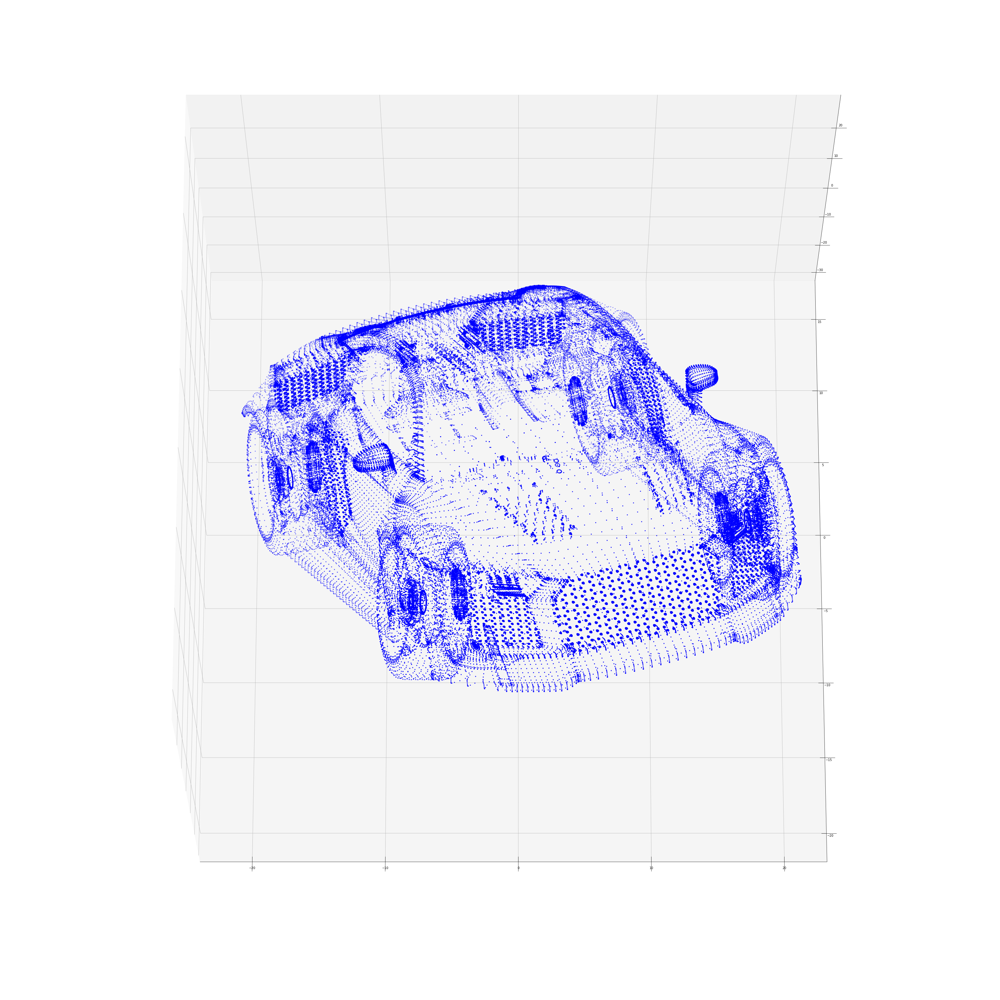

In [5]:
points_cloud = trimesh.PointCloud(vertices=mesh.vertices)

fig = plt.figure(figsize=(60, 60))
fx = plt.axes(projection='3d')
fx.view_init(elev=70, azim=-90)
fx.scatter(points_cloud.vertices[:, 0], points_cloud.vertices[:, 1], points_cloud.vertices[:, 2], c='b', marker='.')
plt.show()

### Функциональное представление

In [6]:
center_mass = mesh.center_mass
query_points = np.array([[center_mass],[[3,3,3]]])

In [7]:
points, sdf = sample_sdf_near_surface(mesh, number_of_points=5000)

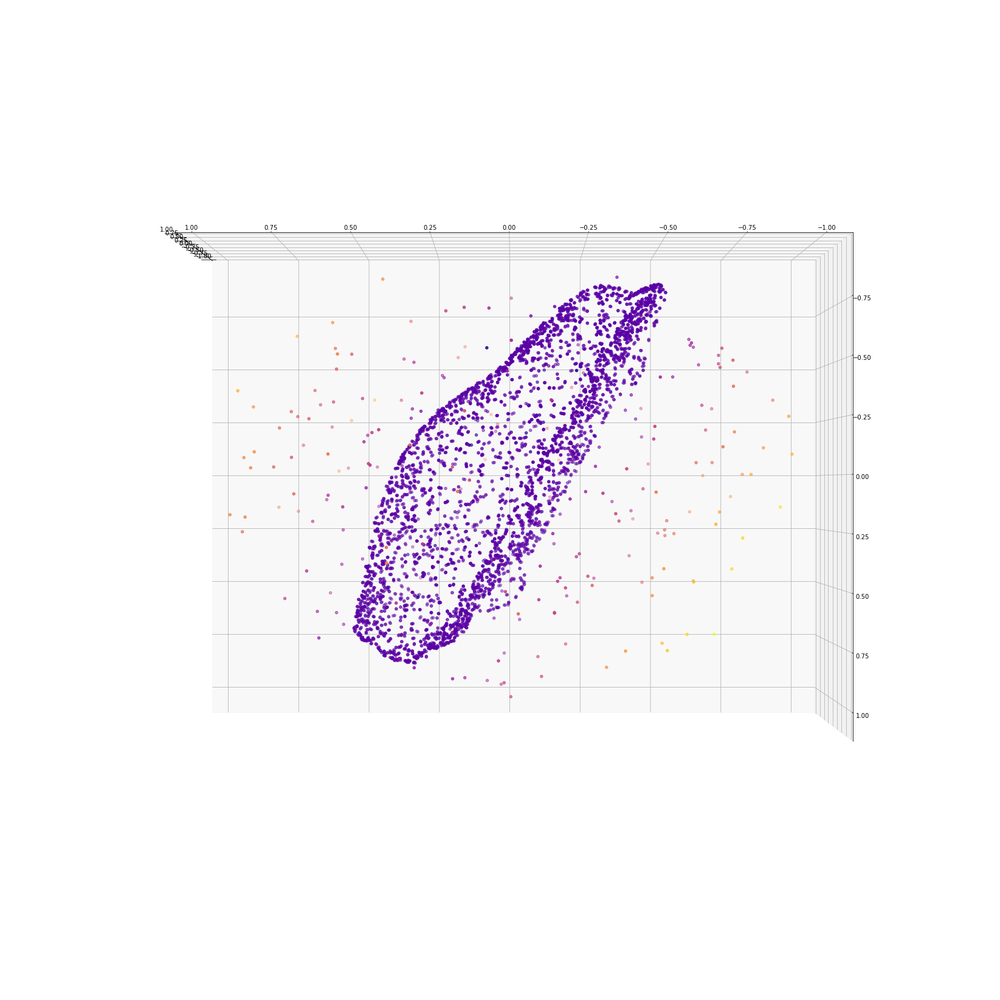

In [8]:
fig = plt.figure(figsize=(30, 30))
ax = fig.add_subplot(111, projection="3d")
ax.view_init(elev=180, azim=180)
ax.scatter(points[:, 0], points[:, 1], zs=-points[:, 2], c=sdf, cmap="plasma")

### 2.5D (depth)

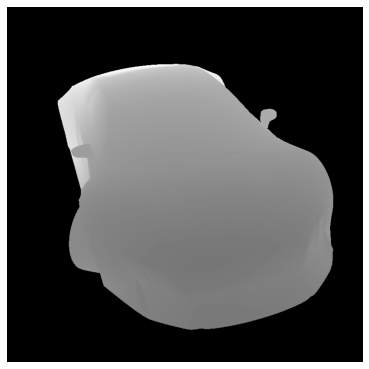

In [9]:
# Извлечение вершин и треугольников
vertices = mesh.vertices
triangles = mesh.faces

# Создание объекта pyrender.Mesh
mesh_prim = pyrender.Mesh.from_trimesh(mesh)


# Создание сцены для рендеринга
scene = pyrender.Scene()
scene.add(pyrender.Mesh.from_trimesh(mesh))

# Создание рендерера
renderer = pyrender.OffscreenRenderer(viewport_width=800, viewport_height=800)

cent = mesh.centroid

s = np.sqrt(2)/12
# Настройка параметров камеры
camera_pose = np.array([
    [10, -s,   s,   -cent[0]],
    [1.0,  15, 5, cent[1]],
    [0.7,  s+3,   s+10,   -cent[2]*20],
    [0.0,  0.0, 0.0, 1.0]])
camera = pyrender.PerspectiveCamera(yfov=np.pi / 5.0, aspectRatio=1.414)
scene.add(camera, pose=camera_pose)

light = pyrender.SpotLight(color=np.ones(3), intensity=3.0, innerConeAngle=np.pi/16.0,outerConeAngle=np.pi/6.0)
scene.add(light, pose=camera_pose)

# Рендеринг сцены
color, depth = renderer.render(scene)

# Получение карты глубины
depth_map = np.flipud(depth)

# Визуализация карты глубины
import matplotlib.pyplot as plt
plt.figure(figsize=(14,14))
plt.subplot(1,2,2)
plt.axis('off')
plt.imshow(depth, cmap=plt.cm.gray)
plt.show()